# Libraries Import

In [1]:
import Channel.parameters as params
import Channel.transmitor as tx
import Channel.modulator as md
import Channel.channel as ch
import Channel.equalizer as eqz
import NNet.NNetGenerator as nnet

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

from numpy import save
from numpy import load

In [6]:
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.utils import shuffle
from sklearn.preprocessing import MinMaxScaler

In [7]:
# For styling the figures.

from IPython.core.display import HTML
HTML("""
<style>
.output_png {
    display: table-cell;
    text-align: center;
    vertical-align: middle;
}
</style>
""")

In [33]:
# Initializing the variables
N = 750
nL = 18

In [34]:
# Initialize parameters
parameters = params.Parameters(N, nL)
# Initialize the Transmitor
transmitor = tx.Transmitor()
# Initialize the Transmitor
modulator = md.Modulator()
# Initialize the Channel
channel = ch.Channel()
# Initialize the Equalizer
equalizer = eqz.Equalizer()
# Initialize the NNetGenerator
nnetGen = nnet.NNetGenerator(parameters)

In [10]:
#-----------------------------------------------------------------------------------------#

def run(withPlot):

    # builds the constellation 
    constellation = transmitor.build_constellations(parameters.M) # 16-QAM

    # plots the constellation 
    #self.argand(constellation)
    
    # Bernoulli source, random bits sequence
    b = transmitor.source(parameters.N,parameters.p)

    # symbol sequence
    s = transmitor.bit_to_symb(b, constellation)

    # modulation
    q0t = modulator.mod(parameters.t,constellation, parameters.B)  
    q0f = np.fft.fft(q0t)
    
    
    if withPlot :
        fig1, (ax1, ax2) = plt.subplots(2, figsize = (15, 15))
        fig1.tight_layout(pad=7.0)


        ax1.plot(parameters.t, np.squeeze(q0t.real), 'b-')
        ax1.set_xlabel("Time")
        ax1.set_ylabel("Re(q0t)")
        ax1.set_title("Modulation - Time plot - Re(q0t)")
        ####
        ax2.plot(parameters.f, np.squeeze(np.abs(q0f)), 'b-')
        ax2.set_xlabel("Freq")
        ax2.set_ylabel("Re(q0f)")
        ax2.set_title("Modulation - Freq plot - |q0f|")

    # channel - we take gaussian input
    q0t = parameters.A*np.exp(-parameters.t**2) 
    q0f = np.fft.fft(q0t)

    qzt, qzf = channel.channel(parameters.t, q0t, parameters.z, parameters.sigma02, parameters.B)

    # Equalization
    qzte, qzfe = equalizer.equalize(parameters.t, qzt, parameters.z)

    if withPlot :
        fig2, (ax1, ax2, ax3, ax4, ax5, ax6) = plt.subplots(6, figsize = (15, 15))
        fig2.tight_layout(pad=7.0)

        ###
        ax1.plot(parameters.t, np.squeeze(q0t.real), 'b-')
        ax1.set_xlabel("Time")
        ax1.set_ylabel("Re(q0t)")
        ax1.set_title("Modulation - Time plot - Re(q0t)")

        ###
        ax2.plot(parameters.f, np.squeeze(np.abs(q0f)), 'b-')
        ax2.set_xlabel("Freq")
        ax2.set_ylabel("Abs(q0f)")
        ax2.set_title("Modulation - Freq plot - |q0f|")

        ###        
        ax3.plot(parameters.t, np.squeeze(qzt.real), 'b-')
        ax3.set_xlabel("Time")
        ax3.set_ylabel("Re(qzt)")
        ax3.set_title("Channel - Time plot - Re(qzt)")

        ###
        ax4.plot(parameters.f, np.squeeze(np.abs(qzf)), 'b-')
        ax4.set_xlabel("Freq")
        ax4.set_ylabel("Abs(qzf)")
        ax4.set_title("Channel - Freq plot - |qzf|")

        ###
        ax5.plot(parameters.t, np.squeeze(qzte.real), 'b-')
        ax5.set_xlabel("Time")
        ax5.set_ylabel("Abs(qzf)")
        ax5.set_title("Equalization - Time plot - Re(qzte)")

        ###
        ax6.plot(parameters.f, np.squeeze(np.abs(qzfe)), 'b-')
        ax6.set_xlabel("Freq")
        ax6.set_ylabel("Abs(qzf)")
        ax6.set_title("Equalization - Freq plot - |qzfe|")

        plt.show()

#-----------------------------------------------------------------------------------------#

def generateData(X):
    
    return nnetGen.nnet_gen(X)

#-----------------------------------------------------------------------------------------#

def allPlots(y_qzt, y_qzf, y_qzt_equalized_t, y_qzt_equalized_f, y_gen, y_gen_equalized_t, y_gen_equalized_f):
    fig2, (ax1, ax2, ax3, ax4, ax5, ax6, ax7) = plt.subplots(7, figsize = (15, 15))
    fig2.tight_layout(pad=7.0)


    ###
    ax1.plot(parameters.t, np.squeeze(y_qzt.real), 'b-')
    ax1.set_xlabel("Time")
    ax1.set_ylabel("Abs(y_qzt)")
    ax1.set_title("Channel - Time plot - Re(y_qzt)")

    ###
    ax2.plot(parameters.f, np.squeeze(np.abs(y_qzf)), 'b-')
    ax2.set_xlabel("Freq")
    ax2.set_ylabel("Abs(y_qzf)")
    ax2.set_title("Equalization - Freq plot - |y_qzf|")

    ###
    ax3.plot(parameters.t, np.squeeze(np.abs(y_qzt_equalized_t)), 'b-')
    ax3.set_xlabel("Time")
    ax3.set_ylabel("Abs(y_qzt_equalized_t)")
    ax3.set_title("Equalization of normal input in the Channel - Time plot - |y_qzt_equalized_t|")

    ###
    ax4.plot(parameters.f, np.squeeze(np.abs(y_qzt_equalized_f)), 'b-')
    ax4.set_xlabel("Freq")
    ax4.set_ylabel("Abs(y_qzt_equalized_f)")
    ax4.set_title("Equalization of normal input in the Channel - Freq plot - |y_qzt_equalized_f|")

    ###
    ax5.plot(parameters.t, np.squeeze(np.absolute(y_gen)), 'b-')
    ax5.set_xlabel("Time")
    ax5.set_ylabel("Abs(y_gen)")
    ax5.set_title("NNetGen - Time plot - |y_gen|")

    ###
    ax6.plot(parameters.t, np.squeeze(np.abs(y_gen_equalized_t)), 'b-')
    ax6.set_xlabel("Time")
    ax6.set_ylabel("Abs(y_gen_equalized_t)")
    ax6.set_title("Equalization of NNetGen - Time plot - |y_gen_equalized_t|")

    ###        
    ax7.plot(parameters.f, np.squeeze(np.abs(y_gen_equalized_f)), 'b-')
    ax7.set_xlabel("Freq")
    ax7.set_ylabel("Abs(y_gen_equalized_t)")
    ax7.set_title("Equalization of NNetGen - Freq plot - |y_gen_equalized_f|")

    plt.show()

#-----------------------------------------------------------------------------------------#

def test_dataset(X, parameters, index):
    withPlot = True
    #l = X #X[0:1,:1600] #X_train[100:101,:] #df[0:1,:1600]
    q0t = X[index] #fromRealToComplex(l)
    q0f = np.fft.fft(q0t)

    qzt, qzf = channel.channel(parameters.t, q0t, parameters.z, parameters.sigma02, parameters.B)

    # Equalization
    qzte, qzfe = equalizer.equalize(parameters.t, qzt, parameters.z)

    if withPlot :
        fig2, (ax1, ax2, ax3, ax4, ax5, ax6) = plt.subplots(6, figsize = (15, 15))
        fig2.tight_layout(pad=7.0)

        ###
        ax1.plot(parameters.t, np.squeeze(q0t.real), 'b-')
        ax1.set_xlabel("Time")
        ax1.set_ylabel("Re(q0t)")
        ax1.set_title("Modulation - Time plot - Re(q0t)")

        ###
        ax2.plot(parameters.f, np.squeeze(np.abs(q0f)), 'b-')
        ax2.set_xlabel("Freq")
        ax2.set_ylabel("Abs(q0f)")
        ax2.set_title("Modulation - Freq plot - |q0f|")

        ###        
        ax3.plot(parameters.t, np.squeeze(qzt.real), 'b-')
        ax3.set_xlabel("Time")
        ax3.set_ylabel("Re(qzt)")
        ax3.set_title("Channel - Time plot - Re(qzt)")

        ###
        ax4.plot(parameters.f, np.squeeze(np.abs(qzf)), 'b-')
        ax4.set_xlabel("Freq")
        ax4.set_ylabel("Abs(qzf)")
        ax4.set_title("Channel - Freq plot - |qzf|")

        ###
        ax5.plot(parameters.t, np.squeeze(qzte.real), 'b-')
        ax5.set_xlabel("Time")
        ax5.set_ylabel("Abs(qzf)")
        ax5.set_title("Equalization - Time plot - Re(qzte)")

        ###
        ax6.plot(parameters.f, np.squeeze(np.abs(qzfe)), 'b-')
        ax6.set_xlabel("Freq")
        ax6.set_ylabel("Abs(qzf)")
        ax6.set_title("Equalization - Freq plot - |qzfe|")

        plt.show()
        
#-----------------------------------------------------------------------------------------#

[channel] qzt : [-1.76551542e-03+2.14207862e-03j -1.75538982e-03+2.09702462e-03j
 -1.73501426e-03+2.00766346e-03j -1.70414558e-03+1.87547783e-03j
 -1.66243283e-03+1.70266428e-03j -1.60943341e-03+1.49210075e-03j
 -1.54463406e-03+1.24730397e-03j -1.46747613e-03+9.72377332e-04j
 -1.37738460e-03+6.71950037e-04j -1.27380010e-03+3.51108320e-04j
 -1.15621323e-03+1.53197816e-05j -1.02420028e-03-3.29648136e-04j
 -8.77459589e-04-6.77814347e-04j -7.15847431e-04-1.02307379e-03j
 -5.39412765e-04-1.35928930e-03j -3.48429723e-04-1.68038432e-03j
 -1.43427045e-04-1.98043532e-03j  7.47863998e-05-2.25376236e-03j
  3.05100816e-04-2.49501674e-03j  5.46090096e-04-2.69926448e-03j
  7.96002482e-04-2.86206427e-03j  1.05275778e-03-2.97953905e-03j
  1.31395155e-03-3.04844009e-03j  1.57686646e-03-3.06620261e-03j
  1.83849110e-03-3.03099233e-03j  2.09554602e-03-2.94174207e-03j
  2.34451710e-03-2.79817817e-03j  2.58169572e-03-2.60083597e-03j
  2.80322550e-03-2.35106452e-03j  3.00515485e-03-2.05102010e-03j
  3.18349

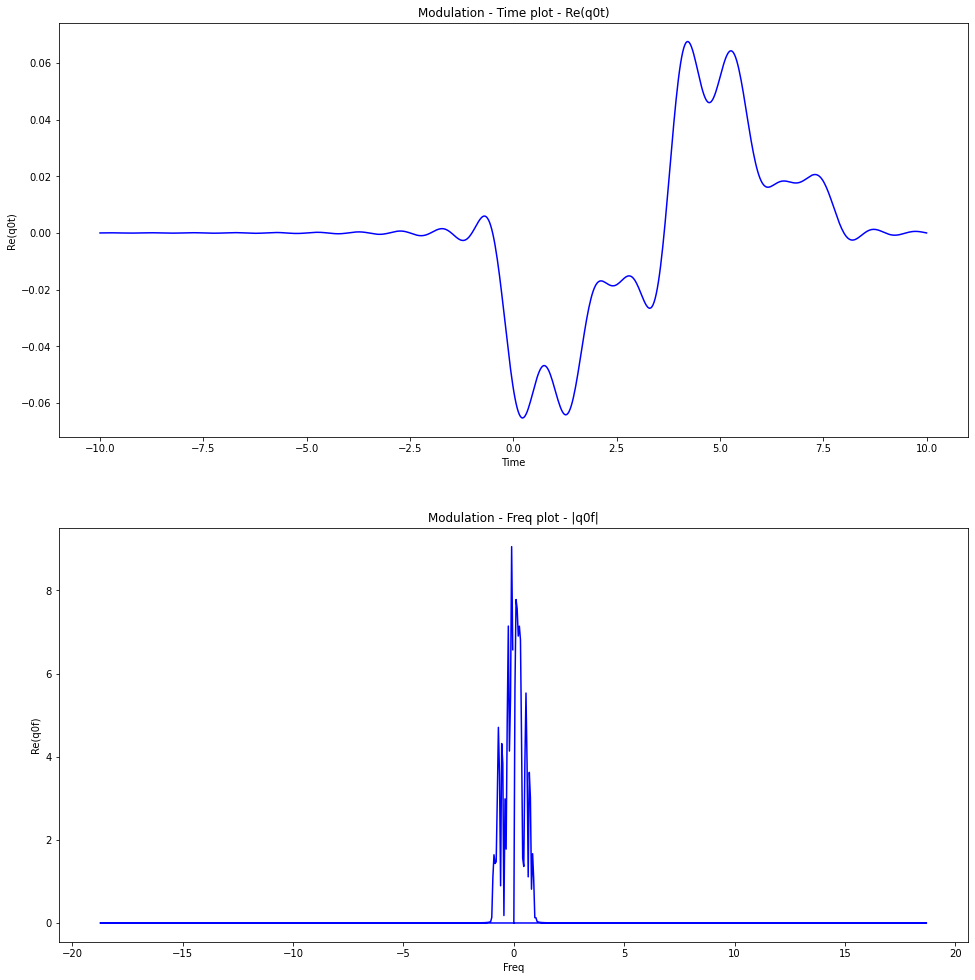

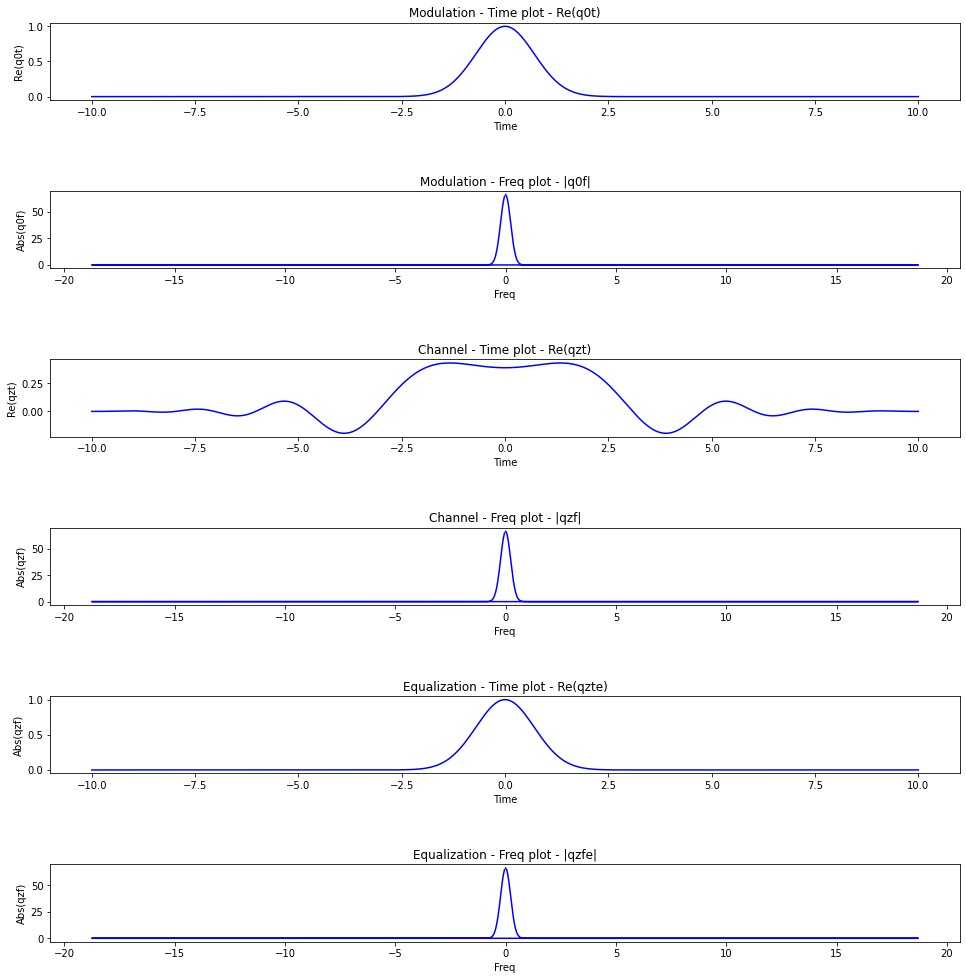

In [10]:
# run the project
withPlot = 1
run(withPlot)

In [8]:
# NNet Genarator
X = parameters.A*np.exp(-parameters.t**2/parameters.s)
y_gen = generateData(X)
print(y_gen)

100%|██████████| 400/400 [01:00<00:00,  6.63it/s]
[-0.+0.j -0.+0.j -0.+0.j ... -0.+0.j -0.+0.j -0.+0.j]


In [10]:
y_qzt, y_qzf = channel.channel(parameters.t, X, parameters.z, parameters.sigma02, parameters.B)

[channel] qzt : [-0.+0.j -0.+0.j -0.+0.j ... -0.+0.j -0.+0.j -0.+0.j]
[channel] qzf : [ 886.14  +0.j   -860.31 -85.46j  740.92+309.26j ... -448.17-550.29j
  741.31+308.33j -860.36 -84.92j]


In [11]:
y_gen_equalized_t, y_gen_equalized_f = equalizer.equalize(parameters.t, y_gen, parameters.z)
y_qzt_equalized_t, y_qzt_equalized_f = equalizer.equalize(parameters.t, y_qzt, parameters.z)

[Equalizer] qzte : [0.+0.j 0.+0.j 0.+0.j ... 0.+0.j 0.+0.j 0.+0.j]
[Equalizer] qzfe : [ 791.61+255.08j -781.33-236.57j  749.86+183.22j ... -695.36-101.65j
  750.09+182.28j -781.48-236.08j]
[Equalizer] qzte : [ 0.-0.j  0.-0.j  0.+0.j ... -0.+0.j -0.-0.j -0.+0.j]
[Equalizer] qzfe : [ 886.14-0.j   -864.55-0.27j  802.87+0.5j  ... -709.71+0.67j  802.87-0.5j
 -864.55+0.27j]


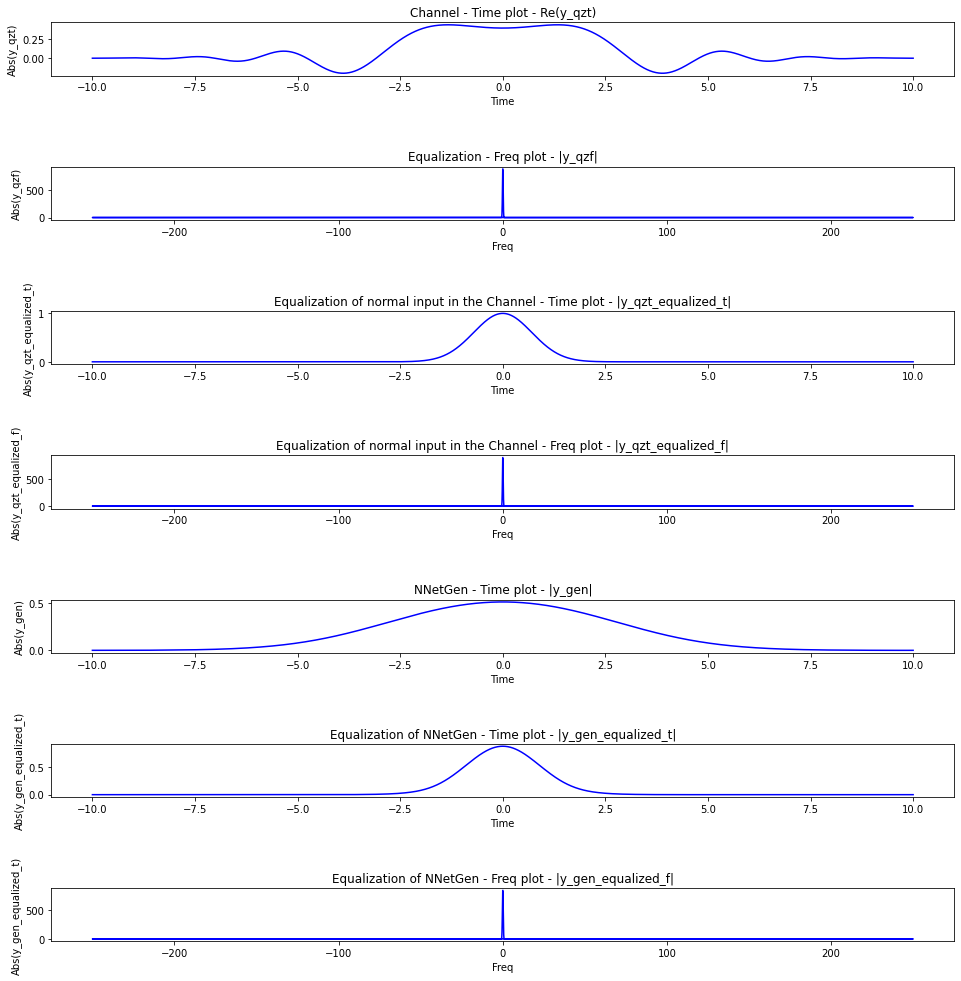

In [12]:
    allPlots(y_qzt, y_qzf, y_qzt_equalized_t, y_qzt_equalized_f, y_gen, y_gen_equalized_t, y_gen_equalized_f)

In [49]:
X_ = parameters.A*np.exp(-parameters.t**2/parameters.s)
Xf = np.fft.fftshift(X_)
Yf = np.fft.fftshift(y_gen)

In [50]:
y_gen

array([-0.+0.j, -0.+0.j, -0.+0.j, ..., -0.+0.j, -0.+0.j, -0.+0.j])

In [51]:
y_gen.mean()

(0.07916101276337166+0.025507679986692552j)

In [11]:
parameters.f.shape

(320,)

Text(0.5, 1.0, 'NNetGen - Freq plot - |y_gen|')

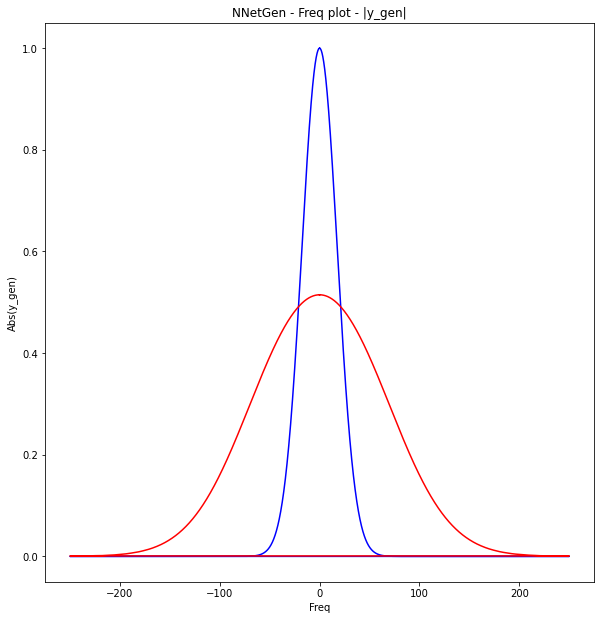

In [53]:
fig3, (ax5) = plt.subplots(1, figsize = (10, 10))
fig3.tight_layout(pad=7.0)

###
ax5.plot(parameters.f, np.absolute(Xf), 'b-', label='nnet')
ax5.set_xlabel("Time")
ax5.set_ylabel("Abs(y_gen)")
ax5.set_title("NNetGen - Time plot - |y_gen|")

###
ax5.plot(parameters.f, np.squeeze(np.absolute(Yf)), 'r-', label='nnet')
ax5.set_xlabel("Freq")
ax5.set_ylabel("Abs(y_gen)")
ax5.set_title("NNetGen - Freq plot - |y_gen|")

Text(0.5, 1.0, 'NNetGen - Freq plot - |y_gen|')

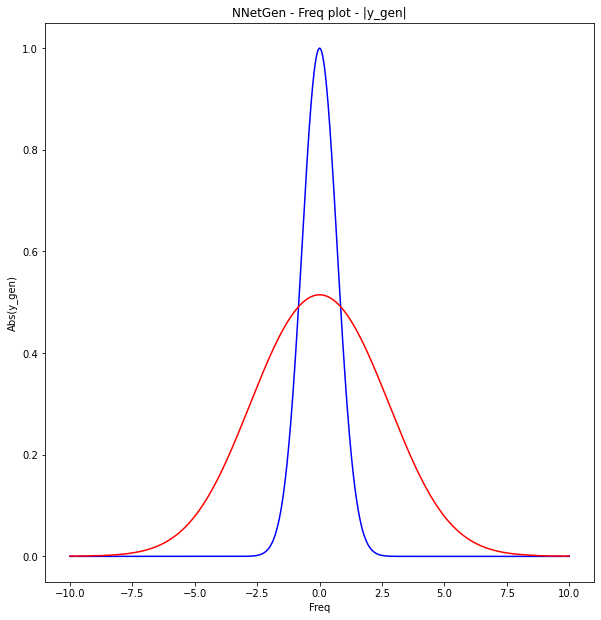

In [54]:
fig3, (ax5) = plt.subplots(1, figsize = (10, 10))
fig3.tight_layout(pad=7.0)

###
ax5.plot(parameters.t, np.absolute(X_), 'b-', label='nnet')
ax5.set_xlabel("Time")
ax5.set_ylabel("Abs(y_gen)")
ax5.set_title("NNetGen - Time plot - |y_gen|")

###
ax5.plot(parameters.t, np.squeeze(np.absolute(y_gen)), 'r-', label='nnet')
ax5.set_xlabel("Freq")
ax5.set_ylabel("Abs(y_gen)")
ax5.set_title("NNetGen - Freq plot - |y_gen|")

In [12]:
#-----------------------------------------------------------------------------------------#

# Generating the dataset
def generateDataset(nbrOfObservations, parameters):

    X = np.ndarray((nbrOfObservations, nbrOfObservations), dtype=np.complex128)
    y = np.ndarray((nbrOfObservations, nbrOfObservations), dtype=np.complex128)

    print("[INFO] Generating the dataset...")

    for i in tqdm(range(1,nbrOfObservations)):
        
        #source
        source = transmitor.source(parameters.N , parameters.p)

        # Constellation
        constellation = transmitor.build_constellations(parameters.M)

        # Bits to Symboles 
        bitsToSymbols = transmitor.bit_to_symb(source, constellation)
        # Modulation
        q0t = modulator.mod(parameters.t, constellation, parameters.B)
        X[:, i] = np.squeeze(q0t)

        # Neural Net Generator
        Y = nnetGen.nnet_gen(q0t)
        y[:, i] = Y

    print("[INFO] The dataset is ready now !")
    return X, y
#-----------------------------------------------------------------------------------------#

def createDataFrame(X,y) :
    X_ = np.column_stack((X.real,X.imag))
    y_ = np.column_stack((y.real,y.imag))
    data = np.column_stack((X_,y_))

    df = pd.DataFrame(data)
    print("df.shape : ",df.shape)
    df.to_csv("generatedData.csv")
    
    return df

#-----------------------------------------------------------------------------------------#
#----------------------------------------------------------------------------#

def fromComplexToReal(vect_im):
  
    vect_real = []

    for i in range(len(vect_im)) :
        tmp = []
        for j in range(len(vect_im[i])) :
            z = vect_im[i][j]
            tmp.append(z.real)
            tmp.append(z.imag)
        vect_real.append(tmp)

    vect_real = np.asarray(vect_real)
    print("{fromComplexToReal} vect_real.shape : ",vect_real.shape)

    return vect_real

#----------------------------------------------------------------------------#

def fromRealToComplex(vect_real):
    
    # init variables
    vect_im = []  

    # iterate over the vector
    for i in range(len(vect_real)) :
        tmp = []
        j = 0

        # we can't use for loop with range() we have no control over the index
        while j < len(vect_real[i]) :

          # y = a+j*b
          im = vect_real[i][j] + 1j*vect_real[i][j+1]
          # we already processed two elements 
          j = j + 2
          # append the new element to the output array
          tmp.append(im)

        # matrix i*j
        vect_im.append(tmp)

    # to numpy
    vect_im = np.asarray(vect_im)
    print("{fromRealToComplex} vect_im.shape : ",vect_im.shape)

    return vect_im

#----------------------------------------------------------------------------#

def prepareDataFrame(X, y) :

    X_real = fromComplexToReal(X)
    y_real = fromComplexToReal(y)

    data = np.column_stack((X_real,y_real))

    df_ = pd.DataFrame(data)

    scaler = MinMaxScaler()
    df_ = scaler.fit_transform(df_)
    df_ = shuffle(df_)

    print("{prepareDataFrame} df_.shape : ",df_.shape)

    return df_

#----------------------------------------------------------------------------#

def prepareTrainAndTestData(df, withReshape, ts):

    #df = df.set_index('Attribute',inplace=True)
  

    N_samples = df.shape[0]
    N_features = df.shape[1]//2
    N_cols = df.shape[1]

    if type(df) != np.ndarray :
        print("[INFO] - {prepareTrainAndTestData} converting from pandas to numpy...")
        df_np = df.to_numpy()
        X = df_np[:N_samples,0:N_features]
        y = df_np[:N_samples,N_features:N_cols]
    else :
        X = df[:N_samples,0:N_features]
        y = df[:N_samples,N_features:N_cols]

    N_features = len(X[0])

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=ts)

    N_samples_train = len(X_train)
    N_samples_test = len(X_test)

    if withReshape :
        X_train = X_train.reshape(N_samples_train, N_features, 1)
        X_test = X_test.reshape(N_samples_test, N_features, 1)
        y_train = y_train.reshape(N_samples_train, N_features, 1)
        y_test = y_test.reshape(N_samples_test, N_features, 1)

    print(X.shape)
    print(y.shape)
    print(X_train.shape)
    print(y_train.shape)
    print(X_test.shape)
    print(y_test.shape)

    return X_train, X_test, y_train, y_test
  
#----------------------------------------------------------------------------#

In [13]:
nbrOfObservations = 10**3
X, y = generateDataset(nbrOfObservations, parameters)

100%|██████████| 999/999 [18:13<00:00,  1.09s/it][INFO] The dataset is ready now !



In [96]:
# make it in vectorial real an imaginary part stacking on each other
df = createDataFrame(X,y)
df.head()

df.shape :  (1000, 4000)


,0,1,2,3,4,5,6,7,8,9,...,3990,3991,3992,3993,3994,3995,3996,3997,3998,3999
0,0.0,1.102143e-18,1.102143e-18,1.102143e-18,1.102143e-18,1.102143e-18,1.102143e-18,1.102143e-18,1.102143e-18,1.102143e-18,...,-0.007798,-0.007798,-0.007798,-0.007798,-0.007798,-0.007798,-0.007798,-0.007798,-0.007798,-0.007798
1,0.0,4.732386e-06,4.732386e-06,4.732386e-06,4.732386e-06,4.732386e-06,4.732386e-06,4.732386e-06,4.732386e-06,4.732386e-06,...,-0.007271,-0.007271,-0.007271,-0.007271,-0.007271,-0.007271,-0.007271,-0.007271,-0.007271,-0.007271
2,0.0,9.435108e-06,9.435108e-06,9.435108e-06,9.435108e-06,9.435108e-06,9.435108e-06,9.435108e-06,9.435108e-06,9.435108e-06,...,-0.006709,-0.006709,-0.006709,-0.006709,-0.006709,-0.006709,-0.006709,-0.006709,-0.006709,-0.006709
3,0.0,1.403321e-05,1.403321e-05,1.403321e-05,1.403321e-05,1.403321e-05,1.403321e-05,1.403321e-05,1.403321e-05,1.403321e-05,...,-0.006118,-0.006118,-0.006118,-0.006118,-0.006118,-0.006118,-0.006118,-0.006118,-0.006118,-0.006118
4,0.0,1.845269e-05,1.845269e-05,1.845269e-05,1.845269e-05,1.845269e-05,1.845269e-05,1.845269e-05,1.845269e-05,1.845269e-05,...,-0.005500,-0.005500,-0.005500,-0.005500,-0.005500,-0.005500,-0.005500,-0.005500,-0.005500,-0.005500


In [20]:
#i = 159
# Channel
y_qzt, y_qzf = channel.channel(parameters.t, X, parameters.z, parameters.sigma02, parameters.B)
# Equalization
y_gen_equalized_t, y_gen_equalized_f = equalizer.equalize(parameters.t, y, parameters.z)
y_qzt_equalized_t, y_qzt_equalized_f = equalizer.equalize(parameters.t, y, parameters.z)

[channel] qzt : [[-0.-0.j  0.-0.j -0.+0.j ...  0.+0.j -0.-0.j  0.+0.j]
 [ 0.+0.j  0.+0.j  0.+0.j ...  0.+0.j  0.+0.j  0.+0.j]
 [ 0.+0.j  0.+0.j  0.+0.j ...  0.+0.j  0.+0.j  0.+0.j]
 ...
 [ 0.-0.j  0.-0.j  0.-0.j ...  0.-0.j  0.-0.j  0.-0.j]
 [ 0.-0.j  0.-0.j  0.-0.j ...  0.-0.j  0.-0.j  0.-0.j]
 [-0.+0.j -0.-0.j  0.+0.j ... -0.+0.j  0.-0.j -0.+0.j]]
[channel] qzf : [[ 0.  -0.j   -0.  +0.j   -0.  +0.j   ... -0.  +0.j   -0.  +0.j
   0.  +0.j  ]
 [ 0.  +0.01j -0.  -0.j    0.  -0.j   ...  0.  -0.j    0.  -0.j
  -0.  -0.j  ]
 [ 0.01+0.03j -0.  -0.j    0.  -0.j   ...  0.  -0.j    0.  -0.j
  -0.  -0.j  ]
 ...
 [ 0.1 -0.25j -0.  +0.j   -0.  +0.j   ... -0.  +0.j   -0.  +0.j
  -0.  +0.j  ]
 [ 0.05-0.12j -0.  +0.j   -0.  +0.j   ... -0.  +0.j   -0.  +0.j
  -0.  +0.j  ]
 [-0.  +0.j   -0.  -0.j   -0.  -0.j   ...  0.  -0.j    0.  -0.j
   0.  -0.j  ]]
[Equalizer] qzte : [[-0.01-0.01j -0.01-0.01j -0.01-0.01j ... -0.01-0.01j -0.01-0.01j
  -0.01-0.01j]
 [-0.01-0.01j -0.01-0.01j -0.01-0.01j ... -0.01-0.01

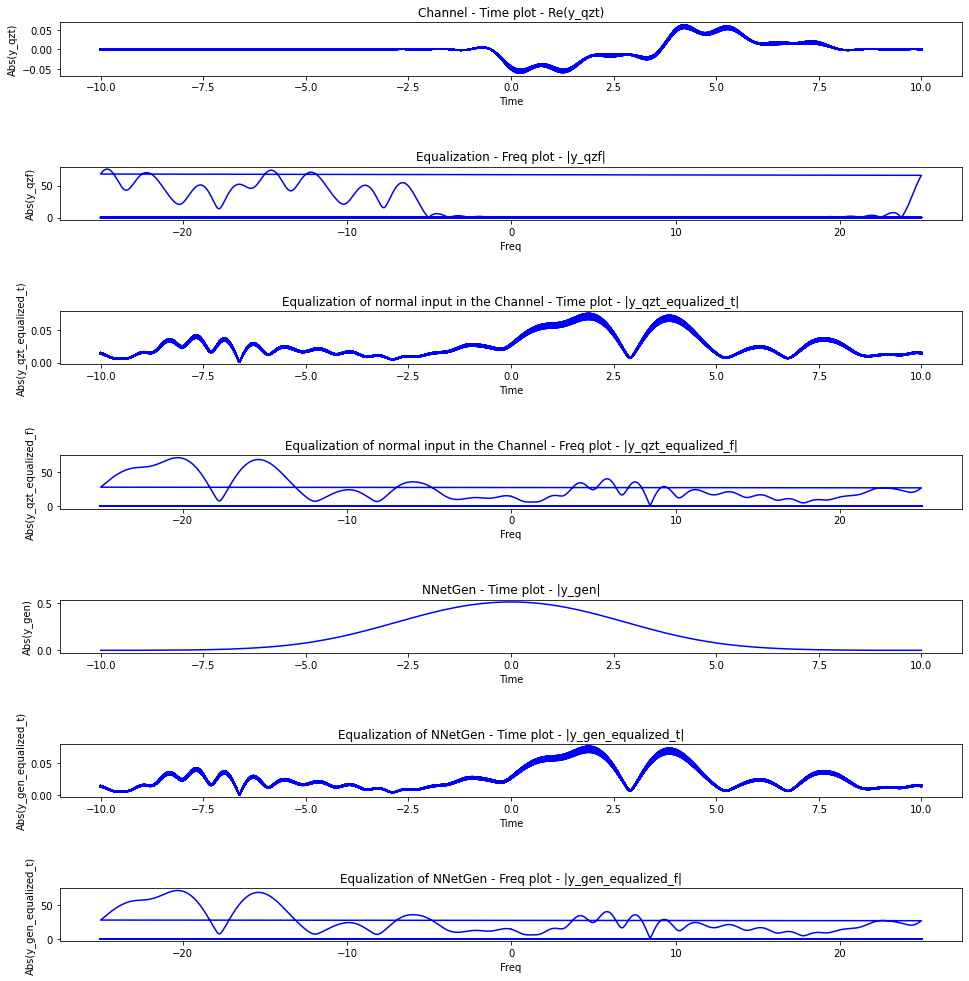

In [24]:
allPlots(y_qzt, y_qzf, y_qzt_equalized_t, y_qzt_equalized_f, y_gen, y_gen_equalized_t, y_gen_equalized_f)

In [40]:
# save to npy file
save('data/y_gen.npy', y_gen)
save('X_data.npy', X)
save('y_data.npy', y)

# Read data

In [30]:
# load array
X = load('data/data gen/X_data.npy')
y = load('data/data gen/y_data.npy')

In [31]:
X.shape

(40000, 750)

[channel] qzt : [ 1.29713212e-02-4.33097238e-03j  3.95397499e-02+1.03778678e-02j
 -2.49493995e-02-1.11459528e-02j  5.59252164e-03+2.39806167e-02j
  5.03760948e-03+4.15357774e-03j  8.76338873e-03-2.41749477e-02j
 -5.17930376e-02+3.17289443e-02j  9.61610075e-03+3.50370832e-02j
 -4.77089219e-02+1.57301465e-02j -1.51916278e-02+9.61144875e-04j
  4.08625834e-02+2.75258942e-02j  2.31091551e-02-3.62667927e-02j
  2.11874156e-02+3.46413039e-03j  3.58019944e-02-6.24618911e-03j
 -7.88267140e-02+7.84128200e-03j  3.23006440e-02+6.31847614e-03j
 -4.05711533e-03+2.22974778e-02j  2.05977590e-02+1.63329854e-02j
  9.06299338e-03-4.80542950e-02j  4.87915398e-03-2.07569722e-02j
 -2.31712461e-02-2.90246522e-02j -4.06007152e-03+7.02006562e-03j
  2.12926187e-02+2.98325417e-03j  1.51672670e-02-4.61177227e-03j
 -4.48686479e-02+7.43396529e-03j -2.42579353e-03-2.83746977e-03j
  3.49338636e-02+1.84623850e-02j -7.38062806e-04-2.80891513e-03j
 -1.53209325e-02+2.97330033e-02j -1.90748949e-02-1.51217898e-03j
  2.77986

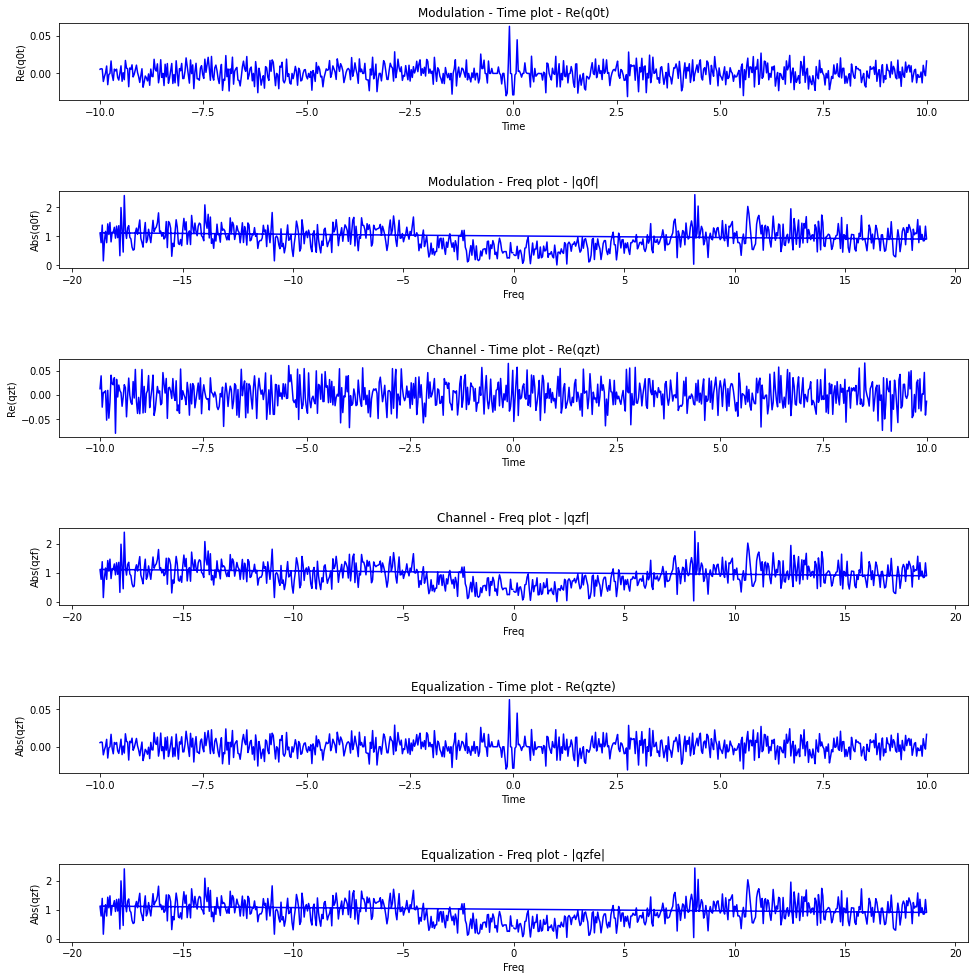

In [35]:
test_dataset(X, parameters, index=3059)

In [36]:
df_np = prepareDataFrame(X, y)

{fromComplexToReal} vect_real.shape :  (40000, 1500)
{fromComplexToReal} vect_real.shape :  (40000, 1500)
{prepareDataFrame} df_.shape :  (40000, 3000)


In [37]:
df_np

array([[0.15125055, 0.        , 0.17278389, ..., 1.        , 0.99999731,
        0.        ],
       [0.15125055, 0.        , 0.17278389, ..., 1.        , 0.99999752,
        0.        ],
       [0.15125055, 0.        , 0.17278389, ..., 1.        , 0.9999976 ,
        0.        ],
       ...,
       [0.15125055, 0.        , 0.17278389, ..., 1.        , 0.99999712,
        0.        ],
       [0.15125055, 0.        , 0.17278389, ..., 1.        , 0.99999677,
        0.        ],
       [0.15125055, 0.        , 0.17278389, ..., 1.        , 0.99999772,
        0.        ]])

In [21]:
data = pd.DataFrame(df_np)

In [ ]:
data

In [43]:
from numpy import load
# load array
data_X = load('data/X_data.npy')
data_y = load('data/y_data.npy')

def createDataFrame(X,y) :
    X_ = np.column_stack((X.real,X.imag))
    y_ = np.column_stack((y.real,y.imag))
    data = np.column_stack((X_,y_))

    df = pd.DataFrame(data)
    print("df.shape : ",df.shape)
    df.to_csv("data/generatedData-2.csv")
    
    return df, data_X, data_y

df, data_X, data_y = createDataFrame(data_X,data_y)

df.shape :  (1000, 4000)


In [ ]:
def stackRealImaginary(X):

    x_ = []
    i = 0
    while i < len(X) :
        z = X[i]
        x_.append(z.real)
        x_.append(z.imag)

        i = i + 2



In [44]:
data_X.shape

(1000, 1000)

In [55]:
data_X_ = np.column_stack((data_X.real,data_X.imag))
data_X_.shape

(1000, 2000)

In [64]:
data_X[850]

01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j, 0.01594187-0.01864215j,
       0.01594187-0.01864215j,

In [62]:
data_X_[850]

array([ 0.        ,  0.01594187,  0.01594187, ..., -0.01864215,
       -0.01864215, -0.01864215])

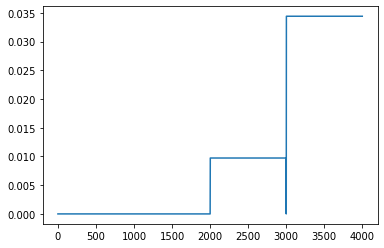

In [50]:
plt.plot(df.to_numpy()[150])

In [18]:
from sklearn.model_selection import train_test_split

df_np = df.to_numpy()
N_samples = len(df)
X = df_np[:N_samples,0:2000]
y = df_np[:N_samples,2001:4001]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

#----------------------------------------------------------------------------#

def goBackToComplexVector(vect):
  
  # init variables
  vect_im = []  
  i =0

  # iterate over the vector
  while i < len(vect) :
    # y = a+j*b
    im = vect[i] + 1j*vect[i+1]
    # append the new element to the output array
    vect_im.append(im)
    # we have a step of 2 because of imaginary part
    i = i+2

  # to numpy
  vect_im = np.asarray(vect_im)
  print(vect_im.shape)

  return vect_im

#----------------------------------------------------------------------------#

In [34]:
index_pred = 150

X_test_im = goBackToComplexVector(X_test[index_pred])
y_test_im = goBackToComplexVector(y_test[index_pred])

Xf = np.fft.fftshift(X_test_im)
Yf = np.fft.fftshift(y_test_im)

print(X_test_im.shape)
print(y_test_im.shape)

fig3, (ax5) = plt.subplots(1, figsize = (10, 10))
fig3.tight_layout(pad=7.0)

fv = np.fft.fftfreq(len(Xf) , parameters.dt)

###
ax5.plot(fv, np.absolute(Xf), 'b-', label='nnet')
ax5.set_xlabel("Time")
ax5.set_ylabel("Abs(y_gen)")
ax5.set_title("NNetGen - Time plot - |y_gen|")

###
ax5.plot(fv, np.squeeze(np.absolute(Yf)), 'r-', label='nnet')
ax5.set_xlabel("Freq")
ax5.set_ylabel("Abs(y_gen)")
ax5.set_title("NNetGen - Freq plot - |y_gen|")

(1000,)
(0,)
(1000,)
(0,)


ValueError: x and y must have same first dimension, but have shapes (1000,) and (0,)